In [3]:
from google.colab import drive
drive.mount('/content/gdrive')
# drive.flush_and_unmount()

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [4]:
root_path = 'gdrive/My Drive/GLCV_Project/'

# **Part One**
> <u><b>Project Objective:</b></u> Creating Face detection from training images.

### **1. Importing the dataset**

In [ ]:
import numpy as np
import warnings
warnings.filterwarnings("ignore")

#Importing the dataset
arr = np.load('/content/gdrive/MyDrive/GLCV_Project/Part 1- Train data - images.npy', allow_pickle = True)

In [ ]:
print("Total test images with faces : ",arr.shape[0], "images")

Total test images with faces :  409 images


In [ ]:
import copy
arr_copy = copy.deepcopy(arr)
gray_img = copy.deepcopy(arr_copy)

(360, 480, 3)


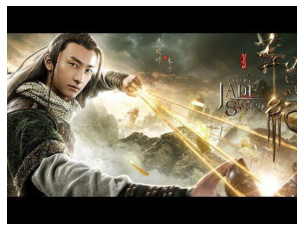

In [ ]:
import matplotlib.pyplot as plt
print(arr[21][0].shape)
plt.imshow(arr[21][0])    #Displying one of the images in the train image samples
plt.axis('off')
plt.show()

### **2. Creating features (images) and labels (mask) using the training data.**

In [ ]:
from google.colab.patches import cv2_imshow
import cv2

In [ ]:
full_img = []
for image in arr_copy:
  
  if image[0].shape[-1] == 3:
    (h, w) = image[0].shape[:2]
    # crd = []
    img = image[0]
    # face_img_per = 0
    full_img.append(img)
print(len(full_img))

397


In [ ]:
totalfaces = 0
faces_set = []
faces = []
masked_img = []

for image in arr:
  
  if image[0].shape[-1] == 3:
    (h, w) = image[0].shape[:2]
    img = image[0]
    label_data = image[1]
    mask1 = np.zeros(img.shape[:2], dtype="uint8")
    for data in label_data:     
        height = data['imageHeight']
        width = data['imageWidth']
        point = data['points']     
        if 'Face' in data['label']:
        x1 = int(point[0]['x'] * w) 
        y1 = int(point[0]['y'] * h)
        x2 = int(point[1]['x'] * w)
        y2 = int(point[1]['y'] * h)
        totalfaces += 1
        cv2.rectangle(mask1, (x1,y1), (x2,y2), 255, -1)
        img2 = cv2.bitwise_and(img,img,mask = mask1)
        masked_img.append(img2)
    ln = len(masked_img)-1
    faces.append(masked_img)
    faces_set.append(faces[0][ln])

In [ ]:
print("Total detected faces: ", totalfaces)

Total detected faces:  1101


### **3. Mask detection model**

#### <i>- Designing a face mask detection model. </i> 

##### 1.   <i>Using U-net along with pre-trained transfer learning models</i>







In [ ]:
image_size = 128

X = np.zeros((len(full_img), image_size, image_size, 1), dtype=np.float32)
y = np.zeros((len(faces_set), image_size, image_size, 1), dtype=np.float32)

for n, id_ in enumerate(full_img):
    index = n

    #Loading images
    img = id_
    img =  cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    resized_img = cv2.resize(img, (image_size, image_size), interpolation = cv2.INTER_AREA)  
    resized_img = np.reshape(resized_img, (image_size,image_size,1))  
    X[index] = resized_img/ 255

    # #Loading masks
    mask_img =  cv2.cvtColor(faces_set[index], cv2.COLOR_BGR2GRAY)
    ret, mask_img = cv2.threshold(mask_img, 125, 255, cv2.THRESH_BINARY)
    resized_mask = cv2.resize(mask_img, (image_size, image_size), interpolation = cv2.INTER_AREA)
    resized_mask = np.reshape(resized_mask, (image_size,image_size,1))
    y[index] = resized_mask / 255

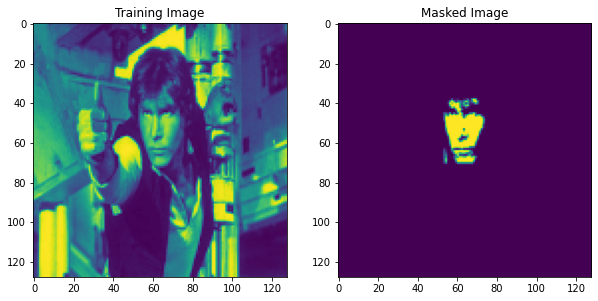

In [ ]:
#Displaying one image and its mask

import random

plt.figure(figsize=(10,5))
idx=random.choice(range(len(full_img)))

plt.subplot(1, 2, 1)
plt.title("Training Image")
plt.imshow(X[idx].squeeze())

plt.subplot(1, 2, 2)
plt.title("Masked Image")
plt.imshow(y[idx].squeeze())

plt.show()

In [ ]:
print(X.shape)
print(y.shape)

(397, 128, 128, 1)
(397, 128, 128, 1)


In [ ]:
#Spliting train and test set
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, random_state=0)

In [ ]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(337, 128, 128, 1)
(337, 128, 128, 1)
(60, 128, 128, 1)
(60, 128, 128, 1)


#### <i>- Designing the Dice Coefficient and Loss function. </i>

In [ ]:
import tensorflow
tensorflow.config.run_functions_eagerly(True)

def dice_coefficient(y_true, y_pred):
    numerator = 2 * tensorflow.reduce_sum(y_true * y_pred)
    denominator = tensorflow.reduce_sum(y_true + y_pred)

    return numerator / (denominator + tensorflow.keras.backend.epsilon())

def loss(y_true, y_pred):
    return tensorflow.keras.backend.binary_crossentropy(y_true, y_pred) - tensorflow.keras.backend.log(dice_coefficient(y_true, y_pred) + tensorflow.keras.backend.epsilon())

 #### <i>- Training, tuning and testing the model.</i>

In [ ]:
pip install git+https://github.com/qubvel/segmentation_models

  Cloning https://github.com/qubvel/segmentation_models to /tmp/pip-req-build-ffiqeik8
  Running command git clone -q https://github.com/qubvel/segmentation_models /tmp/pip-req-build-ffiqeik8
  Running command git submodule update --init --recursive -q
  Created wheel for segmentation-models: filename=segmentation_models-1.0.1-cp37-none-any.whl size=33794 sha256=6bd7b2dd07537d57846a8b0e8682662e762971fb34133237d922c0639fcb2ceb
  Stored in directory: /tmp/pip-ephem-wheel-cache-rh4ro1ti/wheels/49/cf/46/cbb4bb64518c402aea99df9d466f1081450597e653256bbcf4
Successfully built segmentation-models


In [ ]:
%env SM_FRAMEWORK=tf.keras
from segmentation_models import Unet
from tensorflow.keras.optimizers import Adam

#Model 1

unet_model = Unet(backbone_name='resnet34', encoder_weights=None, input_shape=(None, None,1))
unet_model.compile(optimizer='Adam', loss=loss, metrics=[dice_coefficient])

env: SM_FRAMEWORK=tf.keras
Segmentation Models: using `tf.keras` framework.


In [ ]:
unet_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
data (InputLayer)               [(None, None, None,  0                                            
__________________________________________________________________________________________________
bn_data (BatchNormalization)    (None, None, None, 1 3           data[0][0]                       
__________________________________________________________________________________________________
zero_padding2d (ZeroPadding2D)  (None, None, None, 1 0           bn_data[0][0]                    
__________________________________________________________________________________________________
conv0 (Conv2D)                  (None, None, None, 6 3136        zero_padding2d[0][0]             
____________________________________________________________________________________________

In [ ]:
from segmentation_models import get_preprocessing

BACKBONE = 'resnet34'
preprocess_input = get_preprocessing(BACKBONE)
X_train = preprocess_input(X_train)
X_test = preprocess_input(X_test)

In [ ]:
unet_model.fit(
    x=X_train,
    y=y_train,
    batch_size=15,    
    epochs=15,            
    steps_per_epoch=2,       
    validation_data=(X_test, y_test)
    )

Epoch 1/15
2/2 [==============================] - 1s 648ms/step - loss: 0.1568 - dice_coefficient: 0.8770 - val_loss: 0.8542 - val_dice_coefficient: 0.5348
Epoch 2/15
2/2 [==============================] - 1s 534ms/step - loss: 0.1838 - dice_coefficient: 0.8609 - val_loss: 0.8599 - val_dice_coefficient: 0.5314
Epoch 3/15
2/2 [==============================] - 1s 613ms/step - loss: 0.2158 - dice_coefficient: 0.8403 - val_loss: 0.8833 - val_dice_coefficient: 0.5200
Epoch 4/15
2/2 [==============================] - 1s 546ms/step - loss: 0.2099 - dice_coefficient: 0.8348 - val_loss: 0.8856 - val_dice_coefficient: 0.5161
Epoch 5/15
2/2 [==============================] - 1s 568ms/step - loss: 0.1874 - dice_coefficient: 0.8518 - val_loss: 0.8714 - val_dice_coefficient: 0.5219
Epoch 6/15
2/2 [==============================] - 1s 512ms/step - loss: 0.2006 - dice_coefficient: 0.8559 - val_loss: 0.8731 - val_dice_coefficient: 0.5215
Epoch 7/15
2/2 [==============================] - 1s 587ms/step 

#### <i>- Evaluating the model using testing data.</i>

In [ ]:
model_score1 = unet_model.evaluate(X_test, y_test, verbose=0)
print("Test Score:", model_score1[0])
print("Test Accuracy:", model_score1[1]*100)

Test Score: 0.818171501159668
Test Accuracy: 54.250043630599976


In [ ]:
#Model 2

unet_model1 = Unet(backbone_name='resnet50', encoder_weights=None, input_shape=(None, None, 1))
unet_model1.compile(optimizer='Adam', loss=loss, metrics=[dice_coefficient])

In [ ]:
from segmentation_models import get_preprocessing

BACKBONE = 'resnet50'
preprocess_input = get_preprocessing(BACKBONE)
X_train = preprocess_input(X_train)
X_test = preprocess_input(X_test)

In [ ]:
unet_model1.fit(
    x=X_train,
    y=y_train,
    batch_size=15,    
    epochs=15,            
    steps_per_epoch=2,       
    validation_data=(X_test, y_test)
    )

Epoch 1/15
2/2 [==============================] - 1s 808ms/step - loss: 0.3277 - dice_coefficient: 0.7601 - val_loss: 0.8969 - val_dice_coefficient: 0.4868
Epoch 2/15
2/2 [==============================] - 1s 775ms/step - loss: 0.2923 - dice_coefficient: 0.7833 - val_loss: 0.9829 - val_dice_coefficient: 0.4515
Epoch 3/15
2/2 [==============================] - 1s 813ms/step - loss: 0.3538 - dice_coefficient: 0.7455 - val_loss: 1.1002 - val_dice_coefficient: 0.4076
Epoch 4/15
2/2 [==============================] - 1s 784ms/step - loss: 0.3107 - dice_coefficient: 0.7919 - val_loss: 1.0827 - val_dice_coefficient: 0.4151
Epoch 5/15
2/2 [==============================] - 1s 797ms/step - loss: 0.3433 - dice_coefficient: 0.7506 - val_loss: 1.0518 - val_dice_coefficient: 0.4271
Epoch 6/15
2/2 [==============================] - 1s 789ms/step - loss: 0.4209 - dice_coefficient: 0.6997 - val_loss: 1.0602 - val_dice_coefficient: 0.4235
Epoch 7/15
2/2 [==============================] - 1s 791ms/step 

#### <i>- Evaluating the model using testing data.</i>

In [ ]:
model_score2 = unet_model1.evaluate(X_test, y_test, verbose=0)
print("Test Score:", model_score2[0])
print("Test Accuracy:", model_score2[1]*100)

Test Score: 1.0001542568206787
Test Accuracy: 43.37272047996521


### **4. Using the “Prediction image” as an input to designed model and displaying the output of the image.**

In [ ]:
#Saving the better model from the two which have been trained.
#Saving Model 1

unet_model.save("/content/gdrive/MyDrive/GLCV_Project/P1_Resnet.h5")

In [ ]:
from tensorflow.keras.models import load_model

best_model = load_model('/content/gdrive/MyDrive/GLCV_Project/P1_Resnet.h5', custom_objects={'dice_coefficient': dice_coefficient, 'loss':loss})

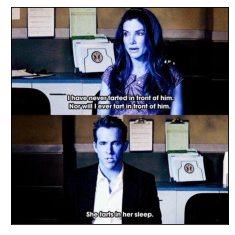

In [ ]:
#Displaying the prediction image

test_img =  cv2.imread("/content/gdrive/MyDrive/GLCV_Project/Part 1Test Data - Prediction Image.jpeg")#, cv2.IMREAD_COLOR)

plt.grid(False)
plt.xticks([])
plt.yticks([])
plt.imshow(test_img, cmap=plt.cm.binary)
plt.show()

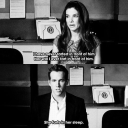

In [ ]:
Xt = np.zeros((len(test_img), image_size, image_size, 1), dtype=np.float32)
test_img =  cv2.cvtColor(test_img, cv2.COLOR_BGR2GRAY)
resized_img = cv2.resize(test_img, (image_size, image_size), interpolation = cv2.INTER_AREA)
resized_img = np.reshape(resized_img, (image_size,image_size,1))  
Xt[0] = resized_img / 255
cv2_imshow(Xt[0]*255)

In [ ]:
pred = best_model.predict(Xt)

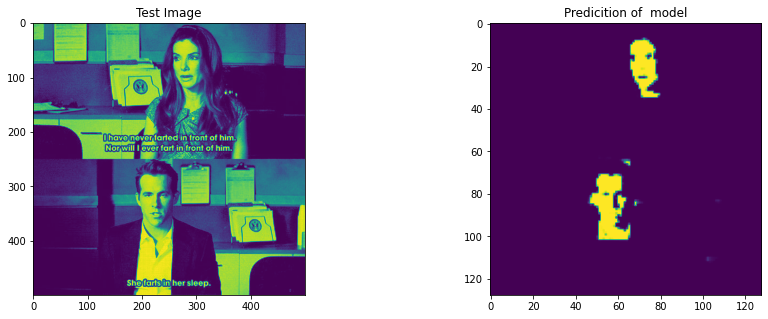

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (15, 5))

ax1.imshow(test_img)
ax1.set_title('Test Image')
ax2.imshow(pred[0].squeeze())
ax2.set_title('Predicition of  model')

plt.show()

# **Part Two**
> <u><b>Project Objective:</b></u> Helping to create an image dataset to be used by the AI team to build an image classifier data.

<i>
Steps followed:

*   Curating the bounding box co-ordinates for each image.
*   Using an automation where we need to input the image in the 
automation and the output is the coordinates of the face detected from the image. 
*   Also highlighting the number of faces detected in an image.
</i>




In [5]:
import os
import cv2
import numpy as np
import pandas as pd
from google.colab.patches import cv2_imshow

In [6]:
import logging
logging.getLogger('tensorflow').disabled = True

In [7]:
train_img = '/content/gdrive/MyDrive/GLCV_Project/training_images/'

In [ ]:
total_face  = 0
img_name = []
no_of_faces = []

non_detected = []
crdX = []
crdY = []
crdW = []
crdH = []

#Initializing Cascade Classifier Object
face_cas = cv2.CascadeClassifier (cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

#Iterating through each image in the folder 'train_img'
for image in os.listdir(train_img):

    #Reading the image and converting it to graycale
    img = cv2.imread(os.path.join(train_img, image))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    #Calling Cascade classifier object
    faces = face_cas.detectMultiScale (img, scaleFactor=1.3, minNeighbors=4)

    #For some images, cascade is not deteting the face, hence checking the output len of Cascase classifier
    if len(faces) != 0:

        #Initializing an list, incase there are multiple faces in the single image
        X_co_ord = []
        Y_co_ord = []
        img_H_size = []
        img_W_size = []

    #Iterating through all the co-ordinates obtained from cascade classifier & appending to the list
    for (x,y,w,h) in faces:
        X_co_ord.append(x)
        Y_co_ord.append(y)
        img_W_size.append(w)
        img_H_size.append(h)

        #Counting the faces obtained in a single image
        total_face = total_face + 1

        #Found out that all thesample images have only one face, but cascade is detecting 2 faces in some cases
        #Because the face is half covered or/ and for unknown reason
        #Hence, breaking from loop after finding the first face co-ordinates
        if total_face == 1:
            break

    #Storing that image's coordinates to the main co-ordinates list and other columns list
    crdX.append(X_co_ord)
    crdY.append(Y_co_ord)
    crdH.append(img_H_size)
    crdW.append(img_W_size)
    no_of_faces.append(total_face)
    img_name.append(image)

    #Initialing this var to 0, for fresh count for the next image
    total_face = 0

    #Getting the images where cascade could not detect teh face for unknown reasons
    elif len(faces) == 0:
        non_detected.append(image)

In [ ]:
#Creating the dataframe as required with 5 columns
data = {'X': crdX, 'Y':crdY, 'W':crdW, 'H': crdH, 'Total Faces': no_of_faces, 'Image Name': img_name}  
df1 = pd.DataFrame(data)
print(df1.shape)
df1.head(5)

(740, 6)


,X,Y,W,H,Total Faces,Image Name
0,[120],[178],[366],[366],1,real_01022.jpg
1,[106],[165],[408],[408],1,real_01065.jpg
2,[85],[92],[444],[444],1,real_01017.jpg
3,[148],[125],[430],[430],1,real_00992.jpg
4,[53],[128],[409],[409],1,real_01002.jpg


In [ ]:
pip install mtcnn 

     |████████████████████████████████| 2.3MB 2.8MB/s 


In [ ]:
from mtcnn.mtcnn import MTCNN

img_name = []
no_of_faces = []
cx = []
cy = []
cw = []
ch = []
non_detected = []

#Iterating through each image in the folder 'train_img'
for image in os.listdir(train_img):

    X_co_ord = []
    Y_co_ord = []
    img_W_size = []
    img_H_size = []
    #Reading the image and converting it to graycale
    img = cv2.imread(os.path.join(train_img+image), cv2.IMREAD_COLOR)

    # detect faces in the image
    detector = MTCNN()
    faces = detector.detect_faces(img)

    if len(faces) == 0:
        non_detected.append(image)
    else:

        for face in faces:

            x,y,w,h,= face['box']
            X_co_ord.append(x)
            Y_co_ord.append(y)
            img_W_size.append(w)
            img_H_size.append(h)

    cx.append(X_co_ord)
    cy.append(Y_co_ord)
    cw.append(img_W_size)
    ch.append(img_H_size)

    no_of_faces.append(len(faces))
    img_name.append(image)   #Image Name

In [ ]:
# Creating the dataframe as required with 5 columns
data = {'X': cx, 'Y':cy, 'W':cw, 'H': ch, 'Total Faces': no_of_faces, 'Image Name': img_name}  
df2 = pd.DataFrame(data)
print(df2.shape)
df2.head(5)

(977, 6)


,X,Y,W,H,Total Faces,Image Name
0,[134],[180],[299],[373],1,real_01022.jpg
1,[126],[161],[343],[417],1,real_01065.jpg
2,[103],[149],[351],[421],1,real_00997.jpg
3,[108],[88],[374],[475],1,real_01017.jpg
4,[164],[111],[378],[481],1,real_00992.jpg


In [10]:
def rect_crd(rect):
    # take a bounding predicted by dlib and convert it
    # to the format (x, y, w, h) as we would normally do with OpenCV
    x = rect.left()
    y = rect.top()
    w = rect.right() - x
    h = rect.bottom() - y

    return (x, y, w, h)

In [11]:
import dlib

train_img = '/content/gdrive/MyDrive/GLCV_Project/training_images/'

img_name = []
no_of_faces = []
cx = []
cy = []
cw = []
ch = []
non_detected = []

#Iterating through each image in the folder 'train_img'
for image in os.listdir(train_img):

    #Initialing new list for co-ordinates 
    X_co_ord = []
    Y_co_ord = []
    img_W_size = []
    img_H_size = []

    #Reading the image
    img = cv2.imread(os.path.join(train_img+image), cv2.IMREAD_COLOR)

    #Initializing Object
    hogFaceDetector = dlib.get_frontal_face_detector()
    faces = hogFaceDetector(img, 0)

    # If no faces detected else append co-ordinates
    if len(faces) == 0:
        non_detected.append(image)

    else:
    #Iterating through teh co-ordinates of the faces detected in an image
        for face in faces:
            (x, y, w, h) = rect_crd(face)

            X_co_ord.append(x)
            Y_co_ord.append(y)
            img_W_size.append(w)
            img_H_size.append(h)

    #Storing the co-ordinates of the face(s) detected in an image
    cx.append(X_co_ord)
    cy.append(Y_co_ord)
    cw.append(img_W_size)
    ch.append(img_H_size)

    no_of_faces.append(len(faces))  # Appending total number of faces
    img_name.append(image)   # Appending Image file name

In [12]:
#Creating the dataframe as required with 5 columns
data = {'X': cx, 'Y':cy, 'W':cw, 'H': ch, 'Total Faces': no_of_faces, 'Image Name': img_name}  
df3 = pd.DataFrame(data)
print(df3.shape)
df3.head(20)

(1019, 6)


,X,Y,W,H,Total Faces,Image Name
0,[164],[233],[310],[309],1,real_01022.jpg
1,[115],[238],[371],[372],1,real_01065.jpg
2,[73],[197],[372],[372],1,real_00997.jpg
3,[115],[156],[371],[371],1,real_01017.jpg
4,[197],[197],[372],[372],1,real_00992.jpg
5,[95],[198],[310],[310],1,real_01002.jpg
6,[73],[156],[372],[371],1,real_00998.jpg
7,[164],[233],[310],[309],1,real_01051.jpg
8,[115],[197],[371],[372],1,real_01055.jpg
9,[130],[233],[309],[309],1,real_00961.jpg


**Challenges faces during this task -**

*   Initially, tried by using HaarCascade XML file for frontal face. But this automation could only detect the faces which are front profile and are completely displayed. The images where faces were half covered by various means or rotated one were not detected. 
*   Also tried combing HaarCascade XML file for eye detection and frontal face. But it was still not detecting all the faces in the images.
*   This algorithm could only detect faces in 740 images out of 1019.
*   To overcome the cons of HaarCascade algorithm, I tried MTCNN (Multi-task Cascaded Convolutional Neural Networks) algorithm which detects rotated faces as well. 
*   Hence, slightly more number of faces were getting successfully detected which were undetected by HaarCascade algorithm.
*   This algorithm could only detect faces in 977 images out of 1019.
*   Lastly, I used face detection functions from dlib library which was successful in detecting all the faces in the images.

# **Part Three**
> <u><b>Project Objective:</b></u> Using a pre-trained model trained on Face recognition to recognise similar faces. Here, we are particularly 
interested in recognising whether two given faces are of the same person or not. 

### **1. Loading the dataset and creating the metadata.**

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
main_folder='/content/gdrive/MyDrive/GLCV_Project/PINS'   #PINS contain sub folders of each celebrity photos
sub_folder = os.listdir(main_folder)
print('The number of sub-folders found is',len(sub_folder)) 

The number of sub-folders found is 100


In [ ]:
subfolder_name = []
for n in sub_folder:
    subfolder_name.append(n)

In [ ]:
celeb_nm = []
substring = "Face"
for n in sub_folder:
    cb_name = n.split('_')
    person_name = cb_name[1].split(' ')
    if len(person_name) == 1:
        person_name = person_name[0].capitalize()
    elif len(person_name) == 2:
        person_name = person_name[0].capitalize() + ' ' + person_name[1].capitalize()
    elif len(person_name) == 3:
        person_name = person_name[0].capitalize() + ' ' + person_name[1].capitalize() + person_name[2].capitalize()
    elif len(person_name) == 4:
        person_name = person_name[0].capitalize() + ' ' + person_name[1].capitalize() + person_name[2].capitalize() + ' ' + person_name[3].capitalize()
    if substring in person_name:
        person_name = person_name.split('Face')
        celeb_nm.append(person_name[0])
    else:
        celeb_nm.append(person_name)

In [ ]:
print('Celebrity Names:\n',celeb_nm)

Celebrity Names:
 ['Amanda Crew', 'Amber Heard', 'Alycia DebnamCarey ', 'Amaury Nolasco', 'Alvaro Morte', 'Anna Gunn', 'Aaron Paul', 'Anne Hathaway', 'Barbara Palvin', 'Alexandra Daddario', 'Brit Marling', 'Brenton Thwaites', 'Cameron Monaghan', 'Betsy Brandt', 'Caity Lotz', 'Brie Larson', 'Benedict Cumberbatch', 'Bryan Cranston', 'Bill Gates', 'Bellamy Blake', 'Dave Franco', 'Chance Perdomo', 'Danielle Panabaker', 'David Mazouz', 'Dominic Purcell', 'Chris Evans', 'Chris Pratt', 'Chadwick Boseman', 'Cobie Smulders', 'Drake', 'Emma Watson', 'Elizabeth Olsen', 'Dwayne Johnson', 'Emilia Clarke', 'Elon Musk', 'Emily BettRickards', 'Eliza Taylor', 'Emma Stone', 'Dua Lipa', 'Gal Gadot', 'Jason Isaacs', 'Jeff Bezos', 'Grant Gustin', 'Gwyneth Paltrow', 'Jon Bernthal', 'Jesse Eisenberg', 'Jim Parsons', 'Henry Cavil', 'Jeremy Renner', 'Jason Momoa', 'Krysten Ritter', 'Maria Pedraza', 'Lindsey Morgan', 'Margot Robbie', 'Kumail Nanjiani', 'Josh Radnor', 'Kiernan Shipka', 'Kit Harington', 'Kristen 

In [ ]:
import cv2

X = [] # images
y = [] # celebrity names

for name in subfolder_name:
    path = os.path.join(main_folder,name)

    for image in os.listdir(path):
        X.append(cv2.resize(cv2.imread(os.path.join(path, image), cv2.COLOR_BGR2RGB), (224,224), interpolation=cv2.INTER_CUBIC))
        y.append(subfolder_name.index(name))

### **2. Checking some samples of metadata.**

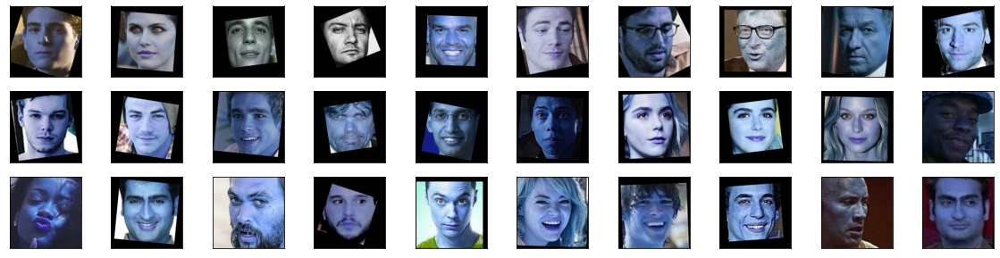

In [ ]:
import cv2
import random

plt.figure(figsize=(20,5))

for i in range(30):
    idx=random.choice(range(len(X)))
    plt.subplot(3,10,i+1)
    plt.xticks([]), plt.yticks([])
    plt.imshow(X[idx])

plt.show()

### **3. Loading the pre-trained model and weights.**

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import ZeroPadding2D, Convolution2D, MaxPooling2D, Dropout, Flatten, Activation

def face_recognition_VGG():

    model = Sequential()
    model.add(ZeroPadding2D((1,1),input_shape=(224,224, 3)))
    model.add(Convolution2D(64, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(64, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
    
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(128, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(128, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
    
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(256, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(256, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(256, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
    
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
    
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
    
    model.add(Convolution2D(4096, (7, 7), activation='relu'))
    model.add(Dropout(0.5))
    model.add(Convolution2D(4096, (1, 1), activation='relu'))
    model.add(Dropout(0.5))
    model.add(Convolution2D(2622, (1, 1)))
    model.add(Flatten())
    model.add(Activation('softmax'))

    return model

In [ ]:
#Loading the weights h5 file

model = face_recognition_VGG()
weight_path = '/content/gdrive/MyDrive/GLCV_Project/Part 3 - vgg_face_weights.h5'
model.load_weights(weight_path)

### **4. Generating Embedding vectors for each face in the dataset.**

In [ ]:
from tensorflow.keras.models import Model
face_vector = Model(inputs=model.layers[0].input, outputs=model.layers[-2].output)

In [ ]:
embedding_vectors = np.zeros((X.shape[0], 2622))

for i, im in enumerate(X):

    # Normalising the image samples
    c_img = (im / 255.).astype(np.float32)
    sample = np.expand_dims(c_img, axis=0)
    embedding_vectors[i] = face_vector.predict(sample)[0]

In [ ]:
embedding_vectors[0]

array([-0.00778061, -0.00197698,  0.00235563, ..., -0.01881554,
       -0.00789146,  0.03059159])

### **5. Building distance metrics for identifying the distance between two given images**

In [ ]:
def distance(emb1, emb2):
    return np.sum(np.square(emb1 - emb2))

In [ ]:
def image_distance(idx1, idx2):
    plt.figure(figsize=(8,3))
    plt.suptitle(f'Distance = {distance(embedding_vectors[idx1], embedding_vectors[idx2])}')
    plt.subplot(121)
    plt.imshow(X[idx1])
    plt.subplot(122)
    plt.imshow(X[idx2])


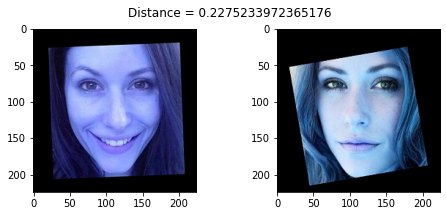

In [ ]:
image_distance(0,11)

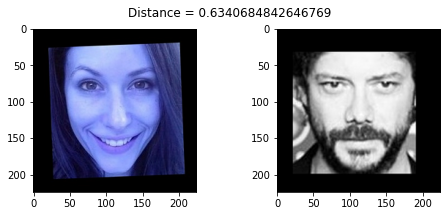

In [ ]:
image_distance(0,596)

### **5. Using PCA for dimensionality reduction.**

In [ ]:
#Convert list to numpy array
X = np.array(X)
y = np.array(y)

In [ ]:
tr_index = np.arange(X.shape[0]) % 2 != 0
ts_index = np.arange(X.shape[0]) % 2 == 0

In [ ]:
#50 train examples of 10 identities (5 examples each)
X_train = embedding_vectors[tr_index]
X_test = embedding_vectors[ts_index]

In [ ]:
print("Shape of train images is:", X_train.shape)
print("Shape of test images is:", X_test.shape)

Shape of train images is: (5423, 2622)
Shape of test images is: (5424, 2622)


In [ ]:
y_train = y[tr_index]
y_test = y[ts_index]

In [ ]:
print("Shape of train images is:", y_train.shape)
print("Shape of test images is:", y_test.shape)

Shape of train images is: (5423,)
Shape of test images is: (5424,)


In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.fit_transform(X_test)

In [ ]:
cov_matrix = np.cov(X_train_scaled,rowvar=False)
print(cov_matrix)

[[ 1.00018443  0.1284984   0.1235535  ...  0.04694238 -0.1161264
  -0.21406333]
 [ 0.1284984   1.00018443  0.2563003  ... -0.04899201  0.30699418
   0.23344405]
 [ 0.1235535   0.2563003   1.00018443 ... -0.10825654  0.05179809
   0.01271715]
 ...
 [ 0.04694238 -0.04899201 -0.10825654 ...  1.00018443  0.00161228
  -0.05134313]
 [-0.1161264   0.30699418  0.05179809 ...  0.00161228  1.00018443
   0.42468796]
 [-0.21406333  0.23344405  0.01271715 ... -0.05134313  0.42468796
   1.00018443]]


In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2622)
pca.fit(X_train_scaled)

PCA(copy=True, iterated_power='auto', n_components=2622, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [ ]:
print(pca.explained_variance_)

[3.58428264e+02 1.55184686e+02 1.02515587e+02 ... 2.57648410e-06
 2.55853186e-06 1.72176156e-07]


In [ ]:
print(pca.explained_variance_ratio_)

[1.36675122e-01 5.91747024e-02 3.90910310e-02 ... 9.82459572e-10
 9.75614061e-10 6.56538545e-11]


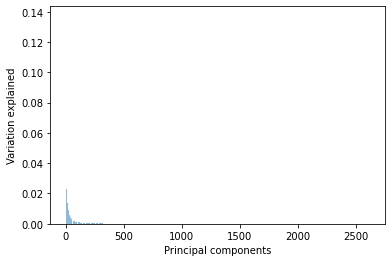

In [ ]:
plt.bar(list(range(1,2623)),pca.explained_variance_ratio_,alpha=0.5, align='center')
plt.ylabel('Variation explained')
plt.xlabel('Principal components')
plt.show()

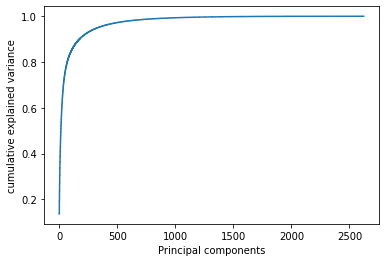

In [ ]:
plt.step(list(range(1,2623)),np.cumsum(pca.explained_variance_ratio_), where='mid')
plt.ylabel('cumulative explained variance')
plt.xlabel('Principal components')

plt.show()

We can determine that around 200 dimensions are able to explain 95% variance of data

In [ ]:
pca_component = PCA(n_components=250, svd_solver='full')
pca_component.fit(X_train_scaled)

PCA(copy=True, iterated_power='auto', n_components=250, random_state=None,
    svd_solver='full', tol=0.0, whiten=False)

In [ ]:
print(pca_component.explained_variance_)

[358.42826446 155.18468569 102.51558717  98.25372689  88.6387966
  81.1904024   71.13989403  60.84646232  55.77138922  50.42221377
  47.49386439  44.77350292  41.80307178  41.32920226  37.74063861
  35.5384876   33.96585     33.45298319  30.19123131  29.52006395
  28.40723992  26.19203327  25.89500425  24.37654241  23.85598742
  22.95891816  21.04745013  20.70711942  19.55622534  18.89607376
  17.64566847  17.16642052  16.3284517   15.7811161   15.30524155
  14.25061049  13.69130249  12.94408423  12.44670015  12.35117708
  11.34485046  11.05282113  10.33001436  10.1249992    9.58220839
   9.2782474    9.03684652   8.81607      8.54550901   8.35463001
   8.30981833   8.09441692   7.82512264   7.56548974   7.32996848
   6.99530077   6.92594979   6.80946116   6.71287017   6.41719122
   6.16626046   6.05571375   5.97338138   5.74704698   5.47510787
   5.40929969   5.25319985   5.18417051   5.10706472   4.82854233
   4.72809898   4.70248343   4.54318237   4.51099871   4.43998475
   4.335398

In [ ]:
print(pca_component.components_)

[[-2.23804292e-02  1.01555111e-02 -3.84827977e-03 ... -5.51781377e-03
   2.22096017e-02  3.85780750e-02]
 [ 2.04257310e-02  8.34114573e-05  9.40459764e-03 ... -2.16114746e-02
  -1.72718530e-03  1.27371424e-02]
 [ 8.76973286e-04  5.28595665e-03  5.85813111e-03 ...  2.02540398e-02
   5.33924280e-03 -3.38184326e-03]
 ...
 [ 1.41597607e-02  3.84276874e-02  4.24306299e-02 ...  2.02019712e-03
  -1.51223285e-02 -2.06105969e-02]
 [ 1.20440472e-02  1.71055025e-03 -3.45431129e-02 ...  2.78753312e-03
  -1.19902949e-02 -1.99544466e-02]
 [-3.57300955e-02  2.25331110e-02  8.22641074e-03 ...  2.50795167e-02
   2.03176745e-02  7.75923181e-03]]


In [ ]:
print(pca_component.explained_variance_ratio_)

[0.13667512 0.0591747  0.03909103 0.03746591 0.03379956 0.03095936
 0.02712692 0.02320185 0.02126663 0.01922689 0.01811026 0.01707294
 0.01594026 0.01575957 0.01439118 0.01355146 0.01295179 0.01275622
 0.01151246 0.01125653 0.01083219 0.00998749 0.00987423 0.00929521
 0.00909672 0.00875465 0.00802577 0.007896   0.00745714 0.00720541
 0.00672861 0.00654586 0.00622633 0.00601762 0.00583616 0.00543401
 0.00522074 0.00493581 0.00474615 0.00470973 0.00432599 0.00421464
 0.00393902 0.00386084 0.00365387 0.00353796 0.00344591 0.00336173
 0.00325856 0.00318577 0.00316868 0.00308655 0.00298386 0.00288486
 0.00279505 0.00266743 0.00264099 0.00259657 0.00255974 0.00244699
 0.00235131 0.00230915 0.00227776 0.00219145 0.00208776 0.00206266
 0.00200314 0.00197682 0.00194742 0.00184121 0.00180291 0.00179314
 0.0017324  0.00172012 0.00169305 0.00165316 0.00160555 0.00159445
 0.00153997 0.00151812 0.00150485 0.00148466 0.00144549 0.00142988
 0.00141409 0.00135284 0.00133815 0.00131839 0.0012821  0.0012

In [ ]:
pca_X_train = pca_component.transform(X_train_scaled)
pca_X_test = pca_component.transform(X_test_scaled)

### **6. Building an SVM classifier to map each image to its right person.**

In [ ]:
from sklearn.svm import LinearSVC
svc = LinearSVC()
svc.fit(pca_X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/svm/_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
          intercept_scaling=1, loss='squared_hinge', max_iter=1000,
          multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
          verbose=0)

In [ ]:
print('Accuracy on training set: {:.2f}%'.format(svc.score(pca_X_train, y_train)*100))
print('Accuracy on test set: {:.2f}%'.format(svc.score(pca_X_test, y_test)*100))

Accuracy on training set: 99.98%
Accuracy on test set: 93.27%


### **7. Predicting using the SVM model.**

In [ ]:
idx=random.choice(range(len(X)))
test_img = X[ts_index][idx]
p3_pred1 = svm.predict([pca_X_test[idx]])

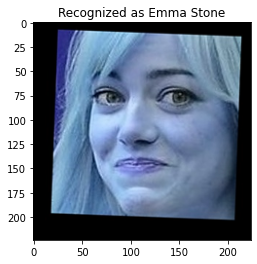

In [ ]:
celebrity = celeb_nm[p3_pred1[0]]

plt.imshow(test_img)
plt.title(f'Recognized as {celebrity}');

# **Part Four**
> <u><b>Project Objective:</b></u> Creating an automation using computer vision to impute dynamic bounding boxes to locate cars or vehicles on the road.

In [ ]:
import numpy as np
import cv2

%matplotlib inline
from matplotlib import pyplot as plt

np.random.seed(42)


In [ ]:
#Routine to fix 
def fixColor(image):
    return(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

In [ ]:
pip install IPython

In [2]:
#Take a look at the input video
# from IPython.display import Video
from IPython.core.display import Video
Video("video1.mp4", embed=True)

In [ ]:
#Ecxtracting background from the video
video_stream = cv2.VideoCapture('/content/gdrive/MyDrive/GLCV_Project/video1.mp4')

# Get the count of the frame
frameIds = video_stream.get(cv2.CAP_PROP_FRAME_COUNT)
frameIds = int(frameIds)
# Store selected frames in an array

frames = []
for fid in range(frameIds):
    video_stream.set(cv2.CAP_PROP_POS_FRAMES, fid)
    ret, frame = video_stream.read()
    frames.append(frame)
    
# video_stream.release()

In [ ]:
writer = cv2.VideoWriter("/content/gdrive/MyDrive/GLCV_Project/output2_P4.mp4", cv2.VideoWriter_fourcc(*"MP4V"), 30,(640,480))

In [ ]:
video_mask = []


from google.colab.patches import cv2_imshow

#Eliminating background and highlighting the objects
bcg_img = cv2.createBackgroundSubtractorMOG2(history = 500, varThreshold = 16, detectShadows = False)
for frame in frames:
    mask = bcg_img.apply(frame)
    video_mask.append(mask)

    #Improving the extraction by removing all the smaller elements and focus our attention on objects that are larger than a certain area.
    _, mask = cv2.threshold(mask, 254, 255, cv2.THRESH_BINARY)

    #Finding the contouring pixels of each object in the mask
    contours, _ = cv2.findContours(mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    #For each contour, we will the area of the contour and impute a bounding box on the objects where area is more than 500
    for cnt in contours:
        # Calculate area and remove small elements
        area = cv2.contourArea(cnt)
        if area > 500:
            x,y,w,h = cv2.boundingRect(cnt)
            # cv2.drawContours(roi, [cnt], -1, (0, 255, 0), 2)
            cv2.rectangle(frame,(x,y),(x+w,y+h),(0,255,0),2)
            # plt.imshow(fixColor(frame))

    writer.write(cv2.resize(frame,(640,480)))

video_stream.release()
writer.release()

In [ ]:
pip install ffmpeg-python

In [ ]:
import ffmpeg
import os
def compress_video(video_full_path, output_file_name, target_size):
    # Reference: https://en.wikipedia.org/wiki/Bit_rate#Encoding_bit_rate
    min_audio_bitrate = 32000
    max_audio_bitrate = 256000

    probe = ffmpeg.probe(video_full_path)
    
    # Video duration, in s.
    duration = float(probe['format']['duration'])

    # Target total bitrate, in bps.
    target_total_bitrate = (target_size * 1024 * 8) / (1.073741824 * duration)

    video_bitrate = target_total_bitrate

    i = ffmpeg.input(video_full_path)
    ffmpeg.output(i, os.devnull,
                  **{'c:v': 'libx264', 'b:v': video_bitrate, 'pass': 1, 'f': 'mp4'}
                  ).overwrite_output().run()
    ffmpeg.output(i, output_file_name,
                  **{'c:v': 'libx264', 'b:v': video_bitrate, 'pass': 1, 'f': 'mp4'}
                  ).overwrite_output().run()

compress_video('/content/gdrive/MyDrive/GLCV_Project/output2_P4.mp4', '/content/gdrive/MyDrive/GLCV_Project/output2_P4_compressed.mp4', 10 * 1000)

In [1]:
from IPython.core.display import HTML
from base64 import b64encode
video_path = 'output2_P4_compressed.mp4'

mp4 = open(video_path,'rb').read()
decoded_vid = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f'<video width=640 controls><source src={decoded_vid} type="video/mp4"></video>')